# FEMDER - Simulação de Camara Reverberante


In [8]:
import sys
sys.path.append('../../')
import femder as fd
import numpy as np
import matplotlib.pyplot as plt


path_to_geo = r"geom/camara_geometria2.brep"
AP = fd.AirProperties(c0 = 343)
AC = fd.AlgControls(AP,20,200,1)

S = fd.Source("spherical")

S.coord = np.array([[1,2.25,1.2]])
S.q = np.array([[0.0001]])

R = fd.Receiver()
R.star([2,1,1.2],0.15)

BC = fd.BC(AC,AP)
BC.normalized_admittance([2,3,4,5,6,7,8],0.02)
grid = fd.GridImport3D(AP,path_to_geo,S,R,fmax = 300,num_freq=6,scale=1000,order=1)
obj = fd.FEM3D(grid,S,R,AP,AC,BC)


[]


In [9]:
obj.plot_problem(saveFig=False,camera_angles=['diagonal_front'],extension='png')

In [10]:
obj.compute()

100%|████████████████████████████████████████████████████████████████████████████████| 181/181 [44:46<00:00, 14.84s/it]


Time taken: 47.682748178641 min


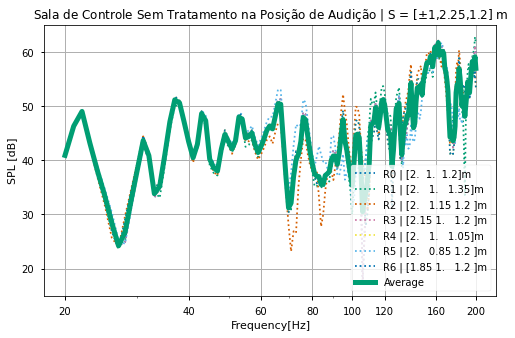

In [15]:
obj.evaluate(R,True);
plt.title('Sala de Controle Sem Tratamento na Posição de Audição | S = [$\pm$1,2.25,1.2] m')
plt.xticks([20,40,60,80,100,120,160,200],[20,40,60,80,100,120,160,200]);


In [12]:
obj.pressure_field(frequencies = 70, renderer='notebook',saveFig=True,axis=['xy','yz'],camera_angles=['diagonal_front'],extension='pdf')

geom/camara_geometria2.brep


100%|█████████████████████████████████████████████████████████████████████████████| 4474/4474 [00:16<00:00, 267.46it/s]



	Elapsed time to evaluate acoustic field: 2.85 minutes



## Absorvedor de Membrana de 70Hz

In [ ]:
tmm70 = fd.TMM(fmin=20,fmax=200,df=1, incidence='normal')
tmm70.membrane_layer(t=2,rho=1800)
tmm70.air_layer(t=10)
tmm70.porous_layer(model='miki', t=150, sigma=15)
tmm70.compute(rigid_backing=True, show_layers=True, conj=False)
tmm70.plot(figsize=(7, 5), plots=['alpha'], saveFig=False, timestamp=False, filename='membrane_70')

## Absorvedor de Membrana de 113Hz

In [ ]:
tmm113 = fd.TMM(fmin=20,fmax=200,df=1, incidence='normal')
tmm113.membrane_layer(t=2,rho=1000)
tmm113.air_layer(t=8)
tmm113.porous_layer(model='miki', t=100, sigma=15)
tmm113.compute(rigid_backing=True, show_layers=True, conj=False)
tmm113.plot(figsize=(7, 5), plots=['alpha'], saveFig=False, timestamp=False, filename='mebrane_113')


# Sala de Controle com membranas aplicadas

In [ ]:
path_to_geo_treat = r"geom/retangular5x4x2.brep"
BC_treat = fd.BC(AC,AP)
BC_treat.normalized_admittance(2,0.02)
BC_treat.TMM(4,tmm70)
BC_treat.TMM(3,tmm113)
grid_treat = fd.GridImport3D(AP,path_to_geo_treat,S,R,fmax = 200,num_freq=6,scale=1,order=1)
obj_treat = fd.FEM3D(grid_treat,S,R,AP,AC,BC_treat)

In [ ]:
obj_treat.plot_problem(renderer='notebook',saveFig=False,camera_angles=['diagonal_front'],extension='png')

In [ ]:
obj_treat.compute()

In [ ]:
obj_treat.evaluate(R,True);
plt.title('Sala de Controle Com Tratamento na Posição de Audição | S = [$\pm$1,2.25,1.2] m')
plt.xticks([20,40,60,80,100,120,160,200],[20,40,60,80,100,120,160,200]);

In [ ]:
obj_treat.pressure_field(frequencies = 70,saveFig= True,camera_angles=['diagonal_front'])